# Análisis Exploratorio de Datos - Fátima

Preguntas que podríamos responder para el usuario:

Empezamos diciendo, revisamos dónde hay más accidentes por alcohol y etc que cachan, pero sabemos que está sesgado a dónde hay alcoholímetros y cámaras en la ciudad

- Hacemos un análisis general y damos algunos datos de horas más inseguras, fechas más inseguras y zonas
- Cuáles son las colonias más inseguras?
- El usuario puede revisar las gráficas de las zonas más inseguras
- Las regulaciones/cámaras muestran ser buenas formas de darnos más seguridad?
- Autopista de cuernavaca
- A qué hora atropellan más ciclistas?
- Cuál es el método más común de reporte?
- En qué colonia hay más muertes?
- Fun factss: Volcaduras
- Creías que el alcoholímetro sirve? Pues no

So structure is:
Estimado peatón, ciclista, motociclista y conductor de la CDMX.
- Gráfica 1: Por día de la semana
- Gráfica 2: Por alcaldía
- Qué tipo de accidentes hay más en cada colonia? Dar a escoger al lector. El key takeaway es que

I want to add:
mapa cdmx: Say look nothing reported there and last,look at the pattern
- Autopista de cuernavaca
- Periferico
- Toluca

¿Qué tan buenas son las regulaciones y métodos de reporte? Las regulaciones/cámaras muestran ser buenas formas de darnos más seguridad?
- Histograma de métodos de reporte de incidentes
- Alcohol casi no se reporta. Creías que el alcoholímetro sirve? Pues no, y solo se reporta en ESTA ubicación
- Ubicaciones de fotomultas? Para excesos de velocidad?

Conclusiones:
- No estamos protegidos de accidentes por alcohol, al menos no está
- Necesitamos más infrastructura para proteger a las personas en zonas marginadas

In [62]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point
import pandas as pd
import numpy as np


# Get the directory of the current file
current_directory = os.path.dirname(os.path.realpath("Layout_proyecto.ipynb"))
current_directory

df.shape

(269933, 17)

In [77]:
df = pd.read_csv('inViales_2022_2024.csv')
df = df[df["incidente_c4"].isin(['Atropellado', 'Choque con lesionados','Choque con lesionados', 'Motociclista', 'Volcadura', 'Choque con prensados',
       'Vehiculo desbarrancado',
       'Ciclista', 'Vehículo atrapadovarado', 'Accidente automovilístico',
       'Incidente de tránsito',
       'Persona atropellada'])]
#df = df.loc[400000:500000] # certain columns and rows # note that it’s a double braces

df.incidente_c4.value_counts()
print(df.head())
df.info()
df.clas_con_f_alarma.value_counts()

                folio fecha_creacion hora_creacion dia_semana fecha_cierre  \
0  C2C/20211229/00212     2021-12-29      23:21:20  Miércoles   2022-01-01   
1  C2C/20211231/00183     2021-12-31      23:48:03    Viernes   2022-01-01   
2  C2C/20220101/00012     2022-01-01      01:06:39     Sábado   2022-01-01   
3  C2C/20220101/00070     2022-01-01      09:51:53     Sábado   2022-01-01   
5  C2N/20220101/00057     2022-01-01      03:33:05     Sábado   2022-01-01   

  hora_cierre tipo_incidente_c4           incidente_c4      alcaldia_inicio  \
0    00:24:06         Lesionado            Atropellado                  NaN   
1    06:29:52         Lesionado            Atropellado           CUAUHTEMOC   
2    06:00:12         Accidente  Choque con lesionados           CUAUHTEMOC   
3    12:54:10         Accidente           Motociclista           CUAUHTEMOC   
5    06:44:09         Accidente  Choque con lesionados  VENUSTIANO CARRANZA   

  codigo_cierre  clas_con_f_alarma      tipo_entrada    

clas_con_f_alarma
URGENCIAS MEDICAS      256624
EMERGENCIA              12834
DELITO                    335
FALSA ALARMA              120
INCIDENTES EXTERNOS        20
Name: count, dtype: int64

In [ ]:
df.incidente_c4.value_counts()
print(df.head())
df.info()
df.clas_con_f_alarma.value_counts()

In [74]:
pivot_table = df.pivot_table(index='alcaldia_catalogo', columns='tipo_entrada', aggfunc='size', fill_value=0)

# Resetting index for better readability
pivot_table.reset_index(inplace=True)

# Sorting the pivot table by 'BOTÓN DE AUXILIO' column in ascending order
pivot_table.sort_values("BOTÓN DE AUXILIO", ascending=True, inplace=True)

# Selecting specific columns for display
pivot_table[["alcaldia_catalogo", "BOTÓN DE AUXILIO"]]

# Calculating the total reports for 'BOTÓN DE AUXILIO'
#total_reportes = pivot_table['BOTÓN DE AUXILIO'].sum()

# Normalizing the 'BOTÓN DE AUXILIO' column by the total reports
# normalized_table = selected_columns.copy()
# normalized_table["BOTÓN DE AUXILIO"] = normalized_table["BOTÓN DE AUXILIO"] / total_reportes

# Displaying the resulting normalized table
# print(normalized_table)


tipo_entrada,alcaldia_catalogo,BOTÓN DE AUXILIO
3,Cuajimalpa de Morelos,240
10,Milpa Alta,293
8,La Magdalena Contreras,469
9,Miguel Hidalgo,1187
12,Tláhuac,1198
0,Azcapotzalco,1245
14,Xochimilco,1270
6,Iztacalco,1475
2,Coyoacán,1562
15,Álvaro Obregón,1595


In [78]:
# Filtering the DataFrame based on the conditions
incident = "Motociclista"

filtered_df = df[(df['incidente_c4'] == incident) & 
                 (df['clas_con_f_alarma'].isin(['URGENCIAS MEDICAS', 'EMERGENCIA']))]

# Counting the number of rows that match the conditions
count_filtered = filtered_df.shape[0]

# Counting the total number of rows in the DataFrame
total_count = df.shape[0]

# Calculating the percentage
percentage = (count_filtered / total_count) * 100

# Displaying the count and percentage
print("Number of ",incident," incidents with 'URGENCIAS MEDICAS' or 'EMERGENCIA':", count_filtered)
print("Percentage of such incidents:", percentage)


# Filtering the DataFrame for the desired clas_con_f_alarma values
filtered_df = df[df['clas_con_f_alarma'].isin(['URGENCIAS MEDICAS', 'EMERGENCIA'])]

# Counting the occurrences of each incidente_c4
incident_counts = filtered_df['incidente_c4'].value_counts()

# Displaying the counts
print("Counts of each incidente_c4 for 'URGENCIAS MEDICAS' and 'EMERGENCIA':")
print(incident_counts)


Number of  Motociclista  incidents with 'URGENCIAS MEDICAS' or 'EMERGENCIA': 50294
Percentage of such incidents: 18.632030911374304
Counts of each incidente_c4 for 'URGENCIAS MEDICAS' and 'EMERGENCIA':
incidente_c4
Choque con lesionados        146747
Atropellado                   52547
Motociclista                  50294
Volcadura                      9040
Ciclista                       6603
Vehículo atrapadovarado        2069
Choque con prensados            936
Accidente automovilístico       691
Vehiculo desbarrancado          263
Incidente de tránsito           242
Persona atropellada              26
Name: count, dtype: int64


In [59]:
df[(df['incidente_c4'] == 'Motociclista')].head(50)

,folio,fecha_creacion,hora_creacion,dia_semana,fecha_cierre,hora_cierre,tipo_incidente_c4,incidente_c4,alcaldia_inicio,codigo_cierre,clas_con_f_alarma,tipo_entrada,alcaldia_cierre,alcaldia_catalogo,colonia_catalogo,longitud,latitud
3,C2C/20220101/00070,2022-01-01,09:51:53,Sábado,2022-01-01,12:54:10,Accidente,Motociclista,CUAUHTEMOC,A,URGENCIAS MEDICAS,RADIO,CUAUHTEMOC,Miguel Hidalgo,Tlaxpana,-99.165781,19.443649
6,C2O/20211231/00213,2021-12-31,21:47:36,Viernes,2022-01-01,02:40:39,Accidente,Motociclista,XOCHIMILCO,A,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,XOCHIMILCO,Xochimilco,Cerrillos Primera Seccion,-99.020370,19.245690
8,C2O/20220101/00045,2022-01-01,03:43:56,Sábado,2022-01-01,06:54:08,Accidente,Motociclista,IZTAPALAPA,A,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,IZTAPALAPA,Iztapalapa,Celoalliotli,-99.071140,19.291070
13,C2O/20220101/00211,2022-01-01,18:04:34,Sábado,2022-01-01,21:14:10,Accidente,Motociclista,IZTAPALAPA,A,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,IZTAPALAPA,Iztapalapa,Juan Escutia,-99.042190,19.389260
14,C2O/20220101/00212,2022-01-01,18:05:23,Sábado,2022-01-01,21:14:12,Accidente,Motociclista,IZTAPALAPA,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,IZTAPALAPA,Iztapalapa,Juan Escutia,-99.042190,19.389260
16,C2P/20220101/00031,2022-01-01,02:51:16,Sábado,2022-01-01,06:04:08,Accidente,Motociclista,ALVARO OBREGON,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,ALVARO OBREGON,Álvaro Obregón,Merced Gomez,-99.192100,19.369670
19,C2P/20220101/00098,2022-01-01,10:38:56,Sábado,2022-01-01,13:44:10,Accidente,Motociclista,ALVARO OBREGON,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,ALVARO OBREGON,Álvaro Obregón,Belem De Las Flores,-99.214570,19.394720
20,C2P/20220101/00100,2022-01-01,10:41:16,Sábado,2022-01-01,13:44:10,Accidente,Motociclista,ALVARO OBREGON,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,ALVARO OBREGON,Álvaro Obregón,Belem De Las Flores,-99.214570,19.394720
21,C2S/20220101/00082,2022-01-01,16:54:12,Sábado,2022-01-01,20:04:09,Accidente,Motociclista,COYOACAN,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,COYOACAN,Coyoacán,San Francisco Culhuacan Barrio De Santa Ana,-99.119930,19.337270
22,C2S/20220101/00094,2022-01-01,18:30:08,Sábado,2022-01-01,21:34:15,Accidente,Motociclista,COYOACAN,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,COYOACAN,Coyoacán,Pedregal De Santo Domingo,-99.162960,19.329820


In [80]:
import pandas as pd

# Assuming the DataFrame is already loaded and named df
# Loading the second DataFrame
#df2 = pd.read_csv('inViales_2019_2021.csv')

# Creating pivot tables with counts
pivot_table = df.pivot_table(index='alcaldia_catalogo', columns='tipo_entrada', aggfunc='size', fill_value=0)
#pivot_table2 = df2.pivot_table(index='alcaldia_catalogo', columns='tipo_entrada', aggfunc='size', fill_value=0)

# Converting counts to percentages
pivot_table_percentage = pivot_table.div(pivot_table.sum(axis=1), axis=0) * 100
#pivot_table2_percentage = pivot_table2.div(pivot_table2.sum(axis=1), axis=0) * 100

# Resetting index for better readability
pivot_table_percentage.reset_index(inplace=True)
#pivot_table2_percentage.reset_index(inplace=True)

# Display the resulting pivot tables
#print(pivot_table_percentage)
#print(pivot_table2_percentage)
#print(df.shape)

pivot_table


tipo_entrada,APLICATIVOS,BOTÓN DE AUXILIO,CÁMARA,LECTOR DE PLACAS,LLAMADA APP911,LLAMADA DEL 911,RADIO,REDES,SOS MUJERES *765
alcaldia_catalogo,,,,,,,,,
Azcapotzalco,12,726,19,0,3,9798,665,26,0
Benito Juárez,38,925,65,0,0,17342,1159,46,0
Coyoacán,32,810,93,0,1,16810,908,50,0
Cuajimalpa de Morelos,8,111,9,0,0,5383,89,15,0
Cuauhtémoc,59,2263,210,0,1,25205,3537,69,0
Gustavo A. Madero,25,2080,102,0,2,27135,1612,50,0
Iztacalco,22,794,31,0,0,11223,817,37,0
Iztapalapa,89,2703,135,0,12,37233,2417,79,1
La Magdalena Contreras,5,212,10,0,0,3260,144,1,0


In [83]:
#df.alcaldia_catalogo.value_counts().to_csv("alcaldia_counts.csv")
df.alcaldia_catalogo.unique()
df.incidente_c4.value_counts()
df.tipo_entrada.value_counts()

tipo_entrada
LLAMADA DEL 911     235203
RADIO                17342
BOTÓN DE AUXILIO     15285
CÁMARA                 970
REDES                  632
APLICATIVOS            463
LLAMADA APP911          35
LECTOR DE PLACAS         1
SOS MUJERES *765         1
Name: count, dtype: int64

# REMOVE VOLCADURAS

In [ ]:
import pandas as pd
import numpy as np

# Create a mask to identify rows that meet the criteria
mask = (
    ((df['incidente_c4'] == "Volcadura") &
    (df['longitud'].between(-99.18, -99.07)) &
    (df['latitud'].between(19.33, 19.45))) |

    ((df['longitud'].between(-99.25, -99.225)) &
    (df['latitud'].between(19.34, 19.4)))
)

# Get the indices of the rows that meet the criteria
indices_to_consider = df[mask].index

# Determine the number of rows to delete (80% of the rows that meet the criteria)
num_to_delete = int(0.65 * len(indices_to_consider))

# Randomly select indices to delete
indices_to_delete = np.random.choice(indices_to_consider, size=num_to_delete, replace=False)

# Drop the selected rows from the DataFrame
df.drop(indices_to_delete, inplace=True)

# Reset the index if desired
df.reset_index(drop=True, inplace=True)

# Display the resulting DataFrame
df.head()


# REMOVE CICLISTAS

In [85]:
import pandas as pd
import numpy as np

# Create a mask to identify rows that meet the criteria
mask = (
    ((df['incidente_c4'] == "Ciclista") &
    (df['longitud'].between(-99.155, -99.145)) &
    (df['latitud'].between(19.40, 19.43))) |
    
    ((df['incidente_c4'] == "Ciclista") &
    (df['longitud'].between(-99.18, -99.07)) &
    (df['latitud'].between(19.33, 19.45)))
)

# Get the indices of the rows that meet the criteria
indices_to_consider = df[mask].index

# Determine the number of rows to delete (80% of the rows that meet the criteria)
num_to_delete = int(0.65 * len(indices_to_consider))

# Randomly select indices to delete
indices_to_delete = np.random.choice(indices_to_consider, size=num_to_delete, replace=False)

# Drop the selected rows from the DataFrame
df.drop(indices_to_delete, inplace=True)

# Reset the index if desired
df.reset_index(drop=True, inplace=True)

# Display the resulting DataFrame
df.head()


,folio,fecha_creacion,hora_creacion,dia_semana,fecha_cierre,hora_cierre,tipo_incidente_c4,incidente_c4,alcaldia_inicio,codigo_cierre,clas_con_f_alarma,tipo_entrada,alcaldia_cierre,alcaldia_catalogo,colonia_catalogo,longitud,latitud
0,C2C/20211229/00212,2021-12-29,23:21:20,Miércoles,2022-01-01,00:24:06,Lesionado,Atropellado,NaN,I,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,NaN,Cuauhtémoc,Roma Norte,-99.163670,19.421610
1,C2C/20211231/00183,2021-12-31,23:48:03,Viernes,2022-01-01,06:29:52,Lesionado,Atropellado,CUAUHTEMOC,A,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,CUAUHTEMOC,Cuauhtémoc,Obrera,-99.144270,19.409910
2,C2C/20220101/00012,2022-01-01,01:06:39,Sábado,2022-01-01,06:00:12,Accidente,Choque con lesionados,CUAUHTEMOC,A,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,CUAUHTEMOC,Cuauhtémoc,Doctores,-99.148320,19.415250
3,C2C/20220101/00070,2022-01-01,09:51:53,Sábado,2022-01-01,12:54:10,Accidente,Motociclista,CUAUHTEMOC,A,URGENCIAS MEDICAS,RADIO,CUAUHTEMOC,Miguel Hidalgo,Tlaxpana,-99.165781,19.443649
4,C2N/20220101/00057,2022-01-01,03:33:05,Sábado,2022-01-01,06:44:09,Accidente,Choque con lesionados,VENUSTIANO CARRANZA,D,URGENCIAS MEDICAS,BOTÓN DE AUXILIO,VENUSTIANO CARRANZA,Venustiano Carranza,Popular Rastro,-99.115660,19.451360


In [35]:
#df.incidente_c4.unique()
#print(df.colonia_catalogo.value_counts().head(30))
#print(df.alcaldia_catalogo.value_counts())

In [36]:
df[["incidente_c4", "longitud", "latitud"]].to_csv("incidentes_coordenadas.csv", index=False)
print(df[["incidente_c4","longitud", "latitud"]])

                 incidente_c4   longitud    latitud
0                 Atropellado -99.163670  19.421610
1                 Atropellado -99.144270  19.409910
2       Choque con lesionados -99.148320  19.415250
3                Motociclista -99.165781  19.443649
4       Choque con lesionados -99.115660  19.451360
...                       ...        ...        ...
266166            Atropellado -99.262997  19.375108
266167  Choque con lesionados -99.087270  19.320600
266168  Choque con lesionados -99.125200  19.428723
266169  Choque con lesionados -99.119881  19.380011
266170           Motociclista -99.080981  19.369412

[266171 rows x 3 columns]


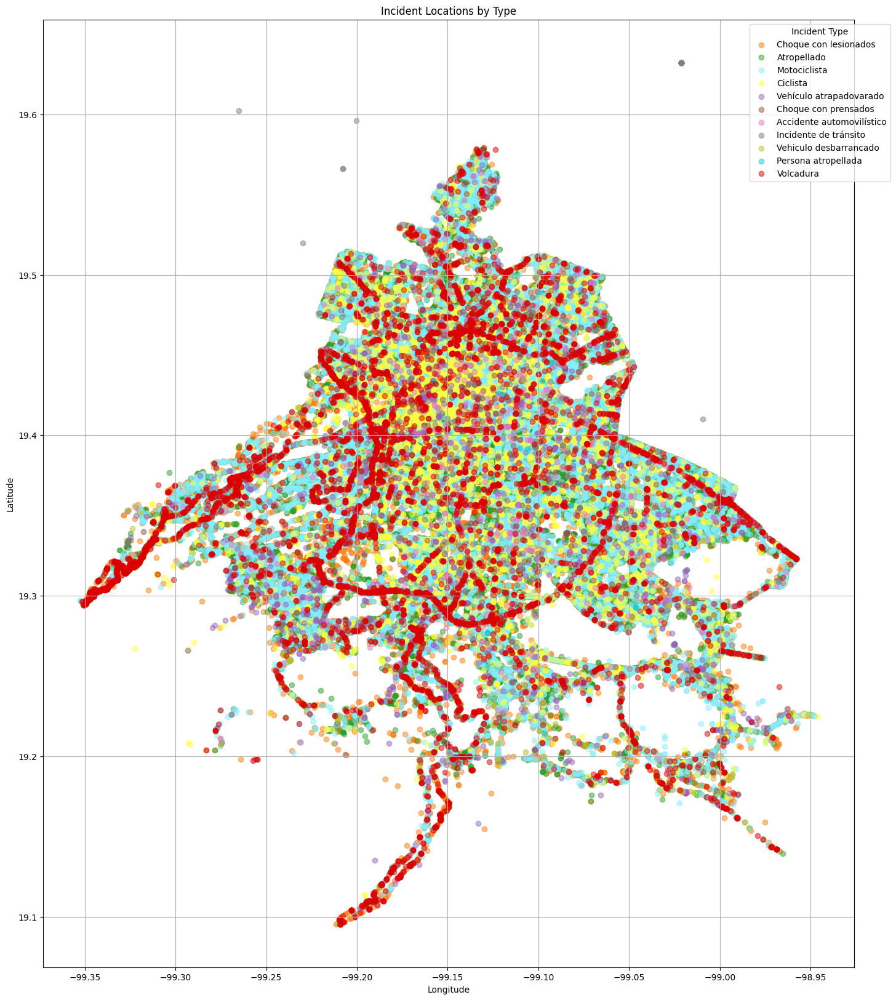

In [38]:
# Load the data
# df = pd.read_csv('inViales_2022_2024.csv')

# Define the incident types you want to include in the map
incident_types_to_include = [
    'Atropellado', 'Choque con lesionados', 'Motociclista',
    'Choque sin lesionados', 'Volcadura', 'Choque con prensados',
    'Vehiculo desbarrancado', 'Persona atrapada / desbarrancada',
    'Ciclista', 'Vehículo atrapadovarado', 'Accidente automovilístico',
    'Incidente de tránsito', 'Persona atropellada'
]

#incident_types_to_include = ['Volcadura']

# Filter the dataframe to include only the desired incident types
df_filtered = df[df["incidente_c4"].isin(incident_types_to_include)]

# Count the frequency of each incident type and sort them in descending order
incident_type_counts = df_filtered['incidente_c4'].value_counts()
sorted_incident_types = [incident for incident in incident_type_counts.index if incident != 'Volcadura']
sorted_incident_types.append('Volcadura')  # Add 'Volcadura' at the end

# Define a list of distinct colors for different incident types
# Red is set specifically for 'Volcadura' and the rest are assigned distinct colors
color_list = [
    '#ff7f0e', '#2ca02c','#84eeff','#ffff3d', '#9467bd', '#8c564b',
    '#e377c2', '#7f7f7f', '#bcbd22', '#17becf','#db0001', '#ff9896'
]


# Create a color dictionary mapping incident types to colors
color_dict = {incident: color_list[i] for i, incident in enumerate(sorted_incident_types)}

# Plotting the coordinates
plt.figure(figsize=(17, 20))
for incident in sorted_incident_types:
    subset = df_filtered[df_filtered['incidente_c4'] == incident]
    plt.scatter(subset['longitud'], subset['latitud'], c=color_dict[incident], label=incident, alpha=0.5)

plt.title('Incident Locations by Type')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='best', bbox_to_anchor=(1.05, 1), title='Incident Type')
plt.grid(True)

# Save the plot as a PNG file
plt.savefig('incident_locations.png', dpi=300, bbox_inches='tight')

plt.show()


STOP HERE

In [41]:
import pandas as pd
import folium
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Load the data
#df = pd.read_csv('inViales_2022_2024.csv')

# Define the incident types you want to include in the map
incident_types_to_include = ['Volcadura']

# Filter the dataframe to include only the desired incident types
df_map = df[df["incidente_c4"].isin(incident_types_to_include)]

# Create a base map
m = folium.Map(location=[df_map['latitud'].mean(), df_map['longitud'].mean()], zoom_start=12)

# Define a colormap or color dictionary
incident_types = df_map['incidente_c4'].unique()
colors = plt.cm.get_cmap('tab20', len(incident_types))
color_dict = {incident: colors(i) for i, incident in enumerate(incident_types)}

# Add points to the map with smaller dots
for incident in incident_types:
    subset = df_map[df_map['incidente_c4'] == incident]
    for _, row in subset.iterrows():
        folium.CircleMarker(
            location=(row['latitud'], row['longitud']),
            radius=1,  # Smaller radius for smaller points
            color=mcolors.to_hex(color_dict[incident]),
            fill=True,
            fill_color=mcolors.to_hex(color_dict[incident]),
            fill_opacity=0.6,
            popup=f"Type: {incident}<br>Location: {row['colonia_catalogo']}"
        ).add_to(m)

m.save('incident_map.html')
m

/var/folders/dh/nbzj0wyx6rq090qyn7s_41nr0000gn/T/ipykernel_7565/2783029131.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab20', len(incident_types))


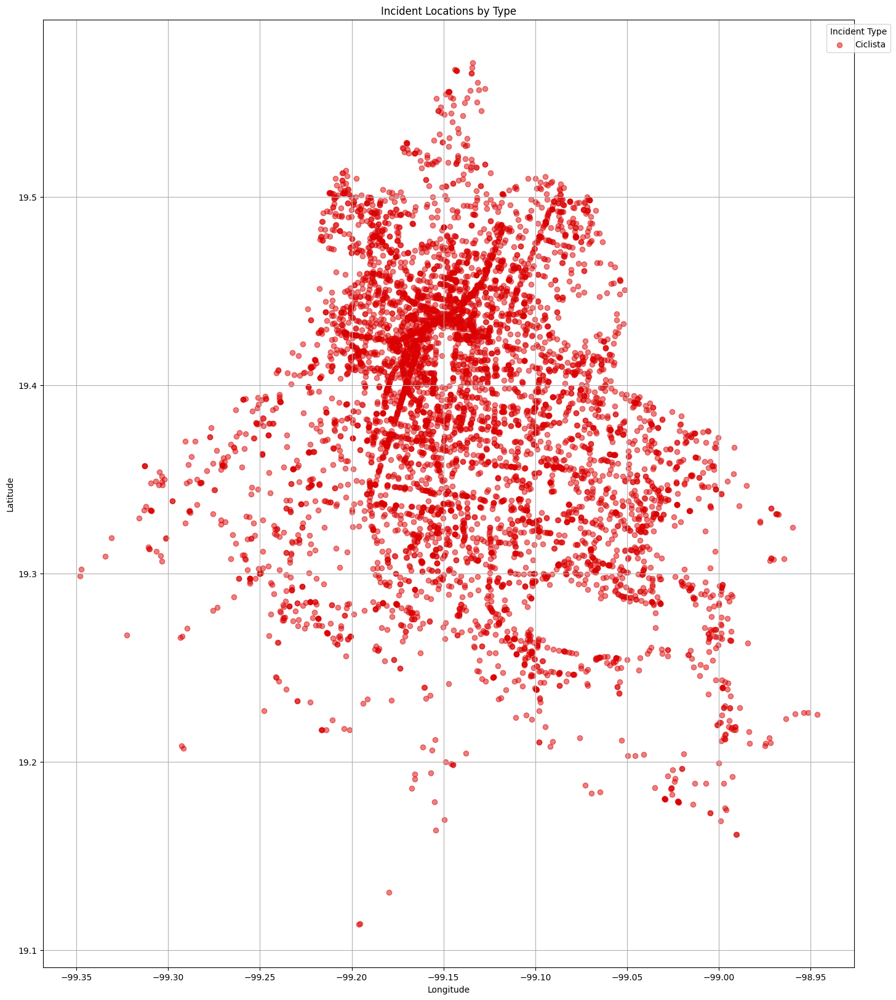

In [92]:
# Load the data
# df = pd.read_csv('inViales_2022_2024.csv')

# Define the incident types you want to include in the map
incident_types_to_include = [
    'Atropellado', 'Choque con lesionados', 'Motociclista',
    'Choque sin lesionados', 'Volcadura', 'Choque con prensados',
    'Vehiculo desbarrancado', 'Persona atrapada / desbarrancada',
    'Ciclista', 'Vehículo atrapadovarado', 'Accidente automovilístico',
    'Incidente de tránsito', 'Persona atropellada'
]

incident_types_to_include = ['Ciclista']

# Filter the dataframe to include only the desired incident types
df_filtered = df[df["incidente_c4"].isin(incident_types_to_include)]

# Count the frequency of each incident type and sort them in descending order
incident_type_counts = df_filtered['incidente_c4'].value_counts()
sorted_incident_types = [incident for incident in incident_type_counts.index if incident != 'Ciclista']
sorted_incident_types.append('Ciclista')  # Add 'Volcadura' at the end

# Define a list of distinct colors for different incident types
# Red is set specifically for 'Volcadura' and the rest are assigned distinct colors
color_list = [
    '#db0001', '#2ca02c','#84eeff','#ffff3d', '#9467bd', '#8c564b',
    '#e377c2', '#7f7f7f', '#bcbd22', '#17becf','#ff7f0e'
]


# Create a color dictionary mapping incident types to colors
color_dict = {incident: color_list[i] for i, incident in enumerate(sorted_incident_types)}

# Plotting the coordinates
plt.figure(figsize=(17, 20))
for incident in sorted_incident_types:
    subset = df_filtered[df_filtered['incidente_c4'] == incident]
    plt.scatter(subset['longitud'], subset['latitud'], c=color_dict[incident], label=incident, alpha=0.5)

plt.title('Incident Locations by Type')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='best', bbox_to_anchor=(1.05, 1), title='Incident Type')
plt.grid(True)

# Save the plot as a PNG file
plt.savefig('ciclista.png', dpi=300, bbox_inches='tight')

plt.show()


In [95]:
import pandas as pd
import folium
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt

# Load the data
# df = pd.read_csv('inViales_2022_2024.csv')

# Define the incident types you want to include in the map
incident_types_to_include = ['Ciclista']

# Filter the dataframe to include only the desired incident types
df_map = df[df["incidente_c4"].isin(incident_types_to_include)]

# Create a base map
m = folium.Map(location=[df_map['latitud'].mean(), df_map['longitud'].mean()], zoom_start=12)

# Define the orange color
orange_color = '#FFA500'

# Add points to the map with smaller dots and fecha_creacion in the popup
for _, row in df_map.iterrows():
    folium.CircleMarker(
        location=(row['latitud'], row['longitud']),
        radius=1,  # Smaller radius for smaller points
        color=orange_color,
        fill=True,
        fill_color=orange_color,
        fill_opacity=0.6,
        popup=f"Incidente: Ciclista<br> Fecha {row['fecha_creacion']}"
    ).add_to(m)

# Save the map to an HTML file
m.save('ciclista.html')

# Display the map
m


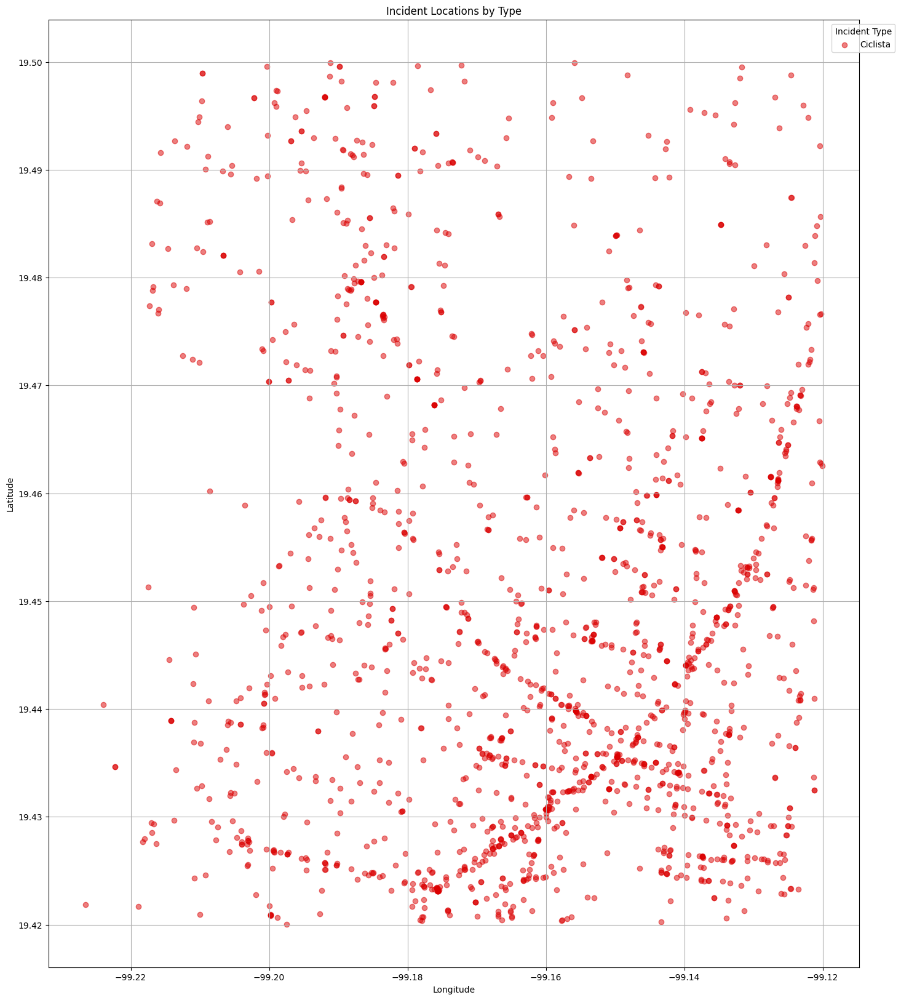

In [93]:
import pandas as pd

# Assuming the dataframe df is already defined and loaded
# Filtering the dataframe based on the given criteria
filtered_df = df[
    (df['incidente_c4'] == "Ciclista") &
    (df['longitud'].between(-99.8, -99.12)) &
    (df['latitud'].between(19.42, 19.5))
]

# Getting the value counts for 'fecha_creacion'
filtered_df['fecha_creacion'].value_counts()


# Load the data
# df = pd.read_csv('inViales_2022_2024.csv')

# Define the incident types you want to include in the map
incident_types_to_include = [
    'Atropellado', 'Choque con lesionados', 'Motociclista',
    'Choque sin lesionados', 'Volcadura', 'Choque con prensados',
    'Vehiculo desbarrancado', 'Persona atrapada / desbarrancada',
    'Ciclista', 'Vehículo atrapadovarado', 'Accidente automovilístico',
    'Incidente de tránsito', 'Persona atropellada'
]

incident_types_to_include = ['Ciclista']

# Filter the dataframe to include only the desired incident types
df_filtered = filtered_df[filtered_df["incidente_c4"].isin(incident_types_to_include)]

# Count the frequency of each incident type and sort them in descending order
incident_type_counts = df_filtered['incidente_c4'].value_counts()
sorted_incident_types = [incident for incident in incident_type_counts.index if incident != 'Ciclista']
sorted_incident_types.append('Ciclista')  # Add 'Volcadura' at the end

# Define a list of distinct colors for different incident types
# Red is set specifically for 'Volcadura' and the rest are assigned distinct colors
color_list = [
    '#db0001', '#2ca02c','#84eeff','#ffff3d', '#9467bd', '#8c564b',
    '#e377c2', '#7f7f7f', '#bcbd22', '#17becf','#ff7f0e'
]


# Create a color dictionary mapping incident types to colors
color_dict = {incident: color_list[i] for i, incident in enumerate(sorted_incident_types)}

# Plotting the coordinates
plt.figure(figsize=(17, 20))
for incident in sorted_incident_types:
    subset = df_filtered[df_filtered['incidente_c4'] == incident]
    plt.scatter(subset['longitud'], subset['latitud'], c=color_dict[incident], label=incident, alpha=0.5)

plt.title('Incident Locations by Type')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='best', bbox_to_anchor=(1.05, 1), title='Incident Type')
plt.grid(True)

# Save the plot as a PNG file
plt.savefig('ciclista1.png', dpi=300, bbox_inches='tight')

plt.show()



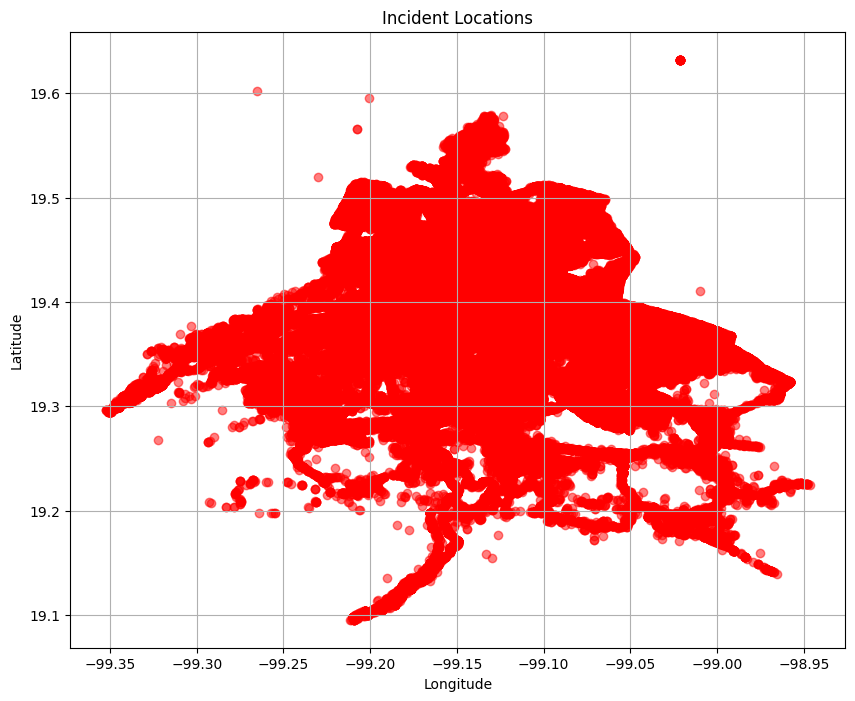

In [37]:
# Plotting the coordinates
plt.figure(figsize=(10, 8))
plt.scatter(df['longitud'], df['latitud'], c='red', alpha=0.5)
plt.title('Incident Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

In [96]:
df1 = pd.read_csv('infracciones_infracciones_transito_2023_b2.csv')
df1.head()

/var/folders/dh/nbzj0wyx6rq090qyn7s_41nr0000gn/T/ipykernel_7565/995160874.py:1: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv('infracciones_infracciones_transito_2023_b2.csv')


,id_infraccion,fecha_infraccion,ao_infraccion,mes,categoria,articulo,fraccion,inciso,parrafo,placa,...,marca,submarca,en_la_calle,entre_calle,y_calle,colonia,alcaldia,codigo_postal,longitud,latitud
0,id-4225409013,2023-03-24,2023,NaN,Otra,5,IX,-----,-----,002A399,...,DESCONOCIDO,YARIS 5 PUERTAS,Eje Central,eje 1,eje central,CENTRO,Cuauhtémoc,NaN,NaN,NaN
1,id-4225363155,2023-03-21,2023,NaN,Otra,6,II,-----,PRIMERO,HG0572C,...,FORD,DESCONOCIDO,Metrobus 6,Ignacio Allende,EJE 5 nte,SAN JUAN DE ARAGÓN,Gustavo A. Madero,NaN,NaN,NaN
2,id-4225548620,2023-04-03,2023,NaN,Otra,6,I,C,PRIMERO,A4159M,...,CHEVROLET,AVEO,Calle Doctor Martínez del Río,José terres,Isabel la católica,DOCTORES,Cuauhtémoc,NaN,NaN,NaN
3,id-4225613632,2023-04-07,2023,NaN,Otra,6,I,A,PRIMERO,A8271G,...,NISSAN,TIIDA SEDÁN 4 PUERTAS,baja California,cuauhtémoc,dr Jiménez,DOCTORES,Cuauhtémoc,NaN,NaN,NaN
4,id-4225694686,2023-04-13,2023,NaN,Otra,6,I,A,PRIMERO,64DFU9,...,DESCONOCIDO,DESCONOCIDO,Vidal Alcocer,peña y peña,Berriozábal,CENTRO,Cuauhtémoc,NaN,NaN,NaN


In [107]:
suma_df = df.alcaldia_catalogo.value_counts().sum()
suma_df1 = df1.alcaldia.value_counts().sum()

print(df.alcaldia_catalogo.value_counts()/(suma_df/100))
print(df1.alcaldia.value_counts()/(suma_df1/100))


alcaldia_catalogo
Iztapalapa                15.831361
Cuauhtémoc                11.600166
Gustavo A. Madero         11.504070
Venustiano Carranza        7.377505
Benito Juárez              7.259519
Tlalpan                    7.180119
Coyoacán                   6.939693
Álvaro Obregón             6.310802
Miguel Hidalgo             5.755745
Iztacalco                  4.795156
Azcapotzalco               4.173685
Xochimilco                 3.824920
Tláhuac                    3.222742
Cuajimalpa de Morelos      2.083318
La Magdalena Contreras     1.347571
Milpa Alta                 0.793627
Name: count, dtype: float64
alcaldia
Miguel Hidalgo            35.294260
Cuauhtémoc                15.898183
Álvaro Obregón            15.869973
Iztapalapa                 9.213452
Benito Juárez              7.414673
Venustiano Carranza        7.177484
Gustavo A. Madero          4.179581
Iztacalco                  1.538205
Coyoacán                   1.320688
Azcapotzalco               0.666098
La Magdal

In [ ]:
import pandas as pd
import folium
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Load the CSV data
map_csv = pd.read_csv('incidentes_coordenadas.csv')
map_csv = map_csv.head(30)

# Create a base map
base_map = folium.Map(location=[19.432608, -99.133209], zoom_start=12)

# Define a colormap or color dictionary
incident_types = map_csv['incidente_c4'].unique()
colors = plt.cm.get_cmap('tab20', len(incident_types))
color_dict = {incident: mcolors.to_hex(colors(i)) for i, incident in enumerate(incident_types)}

# Function to add markers to the map based on incident type
def add_markers(incident_type, map_object):
    subset = map_csv[map_csv["incidente_c4"] == incident_type]
    for _, row in subset.iterrows():
        folium.CircleMarker(
            location=(row['latitud'], row['longitud']),
            radius=3,
            color=color_dict[incident_type],
            fill=True,
            fill_color=color_dict[incident_type],
            fill_opacity=0.6,
        ).add_to(map_object)

# Add all incident types to the map
for incident in incident_types:
    add_markers(incident, base_map)

# Save the map as HTML
base_map.save('incidents_map.html')
base_map